In [1]:
import pandas as pd
import numpy as np
from collections import Counter
import ast
import requests
import json
import pandas as pd
import io
import math
import nltk
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
import gensim
from gensim import corpora
from bertopic import BERTopic
from umap import UMAP
from hdbscan import HDBSCAN
from bertopic.representation import MaximalMarginalRelevance
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt

In [27]:
def get_topic_per_chunk(papers_df, topics):
    # Flatten list of chunks while tracking the document index for each chunk
    final_chunks_list = []
    doc_indices = []
    for doc_index, chunks in enumerate(papers_df["chunks"]):
        for chunk in chunks:
            final_chunks_list.append(chunk)
            doc_indices.append(doc_index)

    # Initialize a structure to hold lists of topics for each chunk of every document
    doc_chunks_topics = defaultdict(list)

    for chunk_topic, doc_idx in zip(topics, doc_indices):
        # Append the topic of each chunk to its corresponding document entry
        doc_chunks_topics[doc_idx].append(chunk_topic)

    # Convert the defaultdict to a regular dict for easier DataFrame mapping
    doc_chunks_topics = dict(doc_chunks_topics)

    # Map the chunk topics to the DataFrame, ensuring every document gets its corresponding list of lists of topics
    papers_df['Chunks_BERTopics'] = papers_df.index.map(doc_chunks_topics.get)
    papers_df_sorted = papers_df.sort_values(by='numChunks', ascending=True)

    return papers_df

In [28]:
papers_df = pd.read_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_content_v3.csv', encoding='utf-8')
papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,cleaned_content_text_noRefs
0,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383,['HAL Id : hal-03222436 https : //hal.inrae.fr...,26,jul multidisciplinary open access archive depo...
1,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192,['HAL Id : hal-00722758 https : //hal.science/...,31,jan multidisciplinary open access archive depo...
2,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071,['Ecology Letters Reduced phenotypic plasticit...,2,ecology letter reduced phenotypic plasticity e...
3,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338,['HAL Id : hal-03321017 https : //hal.science/...,15,aug multidisciplinary open access archive depo...
4,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648,"[""Author Posting . © D. Sol , C. Trisos , C. M...",14,author posting sol trisos múrria jeliazkov gon...
...,...,...,...,...,...,...,...,...
1150,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000,['HAL Id : hal-01335885 https : //hal.science/...,15,jun multidisciplinary open access archive depo...
1151,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000,['HAL Id : hal-03813747 https : //hal.science/...,5,oct multidisciplinary open access archive depo...
1152,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000,['Global data set for nitrogen and carbon stab...,2,data set nitrogen carbon stable isotope tuna n...
1153,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000,['HAL Id : hal-04164752 https : //hal.science/...,7,jul multidisciplinary open access archive depo...


In [29]:
papers_content = papers_df[['fileMain_s','content_text_noRefs']]
papers_content

,fileMain_s,content_text_noRefs
0,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...
1,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...
2,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...
3,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...
4,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri..."
...,...,...
1150,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...
1151,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...
1152,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...
1153,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...


In [6]:
import pandas as pd
import re

def remove_after_last_reference(text):
    if isinstance(text, str):
        # Define a regular expression pattern to identify the reference section with optional numbering
        reference_pattern = re.compile(
            r"\b(?:\d*\s*(?:References|REFERENCE|REFERENCES|Bibliography|LITERATURE CITED))\b", re.IGNORECASE
        )
        
        # Find all occurrences of the reference section
        matches = list(reference_pattern.finditer(text))
        
        # If there are matches, check the last occurrence
        if matches:
            last_match = matches[-1]
            truncated_text = text[:last_match.start()]
            percentage_removed = (len(text) - len(truncated_text)) / len(text) * 100
            
            # Remove only if the reference section is less than 40% of the text
            if percentage_removed < 80:
                return truncated_text, percentage_removed
    
    # If text is not a string, no matches found, or more than 40% would be removed
    return text, 0.0



# Apply the function to the 'content_text' column and split the results into two new columns
papers_content[['content_text_noRefs', 'refs_percentage']] = papers_content['content_text'].apply(
    lambda x: pd.Series(remove_after_last_reference(x))
)

# Sort the DataFrame by 'percentage_removed' in descending order
papers_content = papers_content.sort_values(by='refs_percentage', ascending=False)

# Display the sorted DataFrame
print(papers_content.head())

# Print the percentage of text removed for each article
for index, row in papers_content.iterrows():
    print(f"Article {row['fileMain_s']}: {row['refs_percentage']:.2f}% of the text was removed.")


                                     fileMain_s  \
776  https://hal.inrae.fr/hal-03222436/document   
740   https://hal.science/hal-00722758/document   
422   https://hal.science/hal-02998161/document   
278   https://hal.science/hal-03321017/document   
234   https://hal.science/hal-02551964/document   

                                          content_text  \
776  HAL Id: hal-03222436 https://hal.inrae.fr/hal-...   
740  HAL Id: hal-00722758 https://hal.science/hal-0...   
422  Ecology Letters Reduced phenotypic plasticity ...   
278  HAL Id: hal-03321017 https://hal.science/hal-0...   
234   Author Posting. © D. Sol, C. Trisos, C. Múrri...   

                                  cleaned_content_text  \
776  httpshalinraefrhal jul multidisciplinary open ...   
740  httpshalsciencehal jan multidisciplinary open ...   
422  ecology letter reduced phenotypic plasticity e...   
278  httpshalsciencehal aug multidisciplinary open ...   
234  author posting sol trisos múrria jeliazkov gon...

In [7]:
papers_content

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage
776,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383
740,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192
422,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071
278,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338
234,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648
...,...,...,...,...,...
431,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000
249,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000
257,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000
280,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000


In [ ]:
papers_df = papers_content

In [9]:
#!pip install bertopic

In [30]:
def split_text(text):
    '''
    Receives a text to be splitted into chunks
    Returns list of chunks corresponding to text
    '''
    if not isinstance(text, str):
        return []

    #Tokenize the text into individual words
    tokens = nltk.word_tokenize(text)

    #Initialize an empty list to store the chunks
    chunks = []

    #Calculate the number of chunks needed to split the text into chunks of 512 tokens or less
    num_chunks = math.ceil(len(tokens) / 512)

    #Loop through the number of chunks
    for i in range(num_chunks):
        #Calculate the start and end index for the current chunk
        start_index = i * 512
        end_index = min((i + 1) * 512, len(tokens))

        #Add the current chunk to the list of chunks
        chunks.append(' '.join(tokens[start_index:end_index]))

    return chunks

#Get a list of lists corresponding to the chunks of each paper
chunks_list = []
for index, row in papers_df.iterrows():
    text = row["content_text_noRefs"]
    chunks = split_text(text)
    chunks_list.append(chunks)
papers_df["chunks"] = chunks_list
# 'numChunks' = len('chunks')
papers_df['numChunks'] = papers_df['chunks'].apply(len)

#Single list with all chunks merged in a single list disregarding the paper they came from
final_chunks_list = [p for p_list in papers_df["chunks"] for p in p_list]

papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,cleaned_content_text_noRefs
0,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383,[HAL Id : hal-03222436 https : //hal.inrae.fr/...,26,jul multidisciplinary open access archive depo...
1,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192,[HAL Id : hal-00722758 https : //hal.science/h...,31,jan multidisciplinary open access archive depo...
2,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071,[Ecology Letters Reduced phenotypic plasticity...,2,ecology letter reduced phenotypic plasticity e...
3,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338,[HAL Id : hal-03321017 https : //hal.science/h...,15,aug multidisciplinary open access archive depo...
4,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648,"[Author Posting . © D. Sol , C. Trisos , C. Mú...",14,author posting sol trisos múrria jeliazkov gon...
...,...,...,...,...,...,...,...,...
1150,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000,[HAL Id : hal-01335885 https : //hal.science/h...,15,jun multidisciplinary open access archive depo...
1151,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000,[HAL Id : hal-03813747 https : //hal.science/h...,5,oct multidisciplinary open access archive depo...
1152,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000,[Global data set for nitrogen and carbon stabl...,2,data set nitrogen carbon stable isotope tuna n...
1153,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000,[HAL Id : hal-04164752 https : //hal.science/h...,7,jul multidisciplinary open access archive depo...


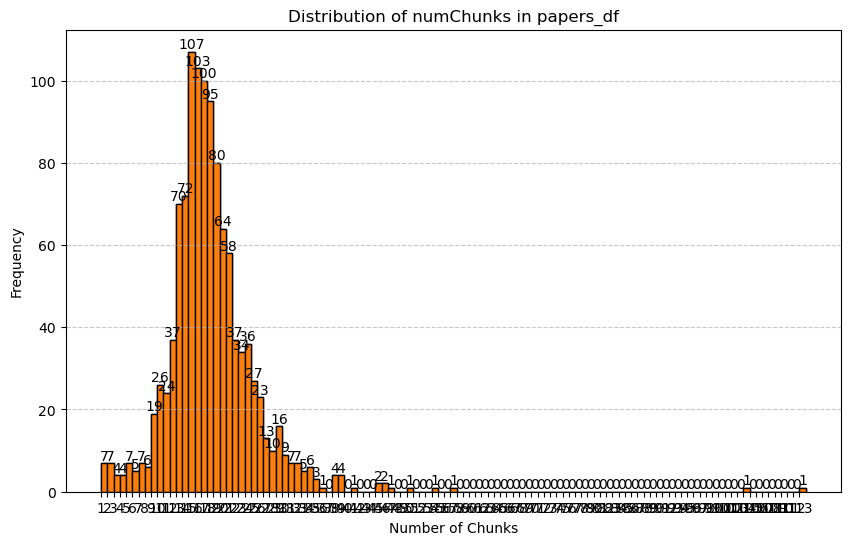

,numChunks,Frequency
0,1,7
1,2,7
2,3,4
3,4,4
4,5,7
5,6,5
6,7,7
7,8,6
8,9,19
9,10,26


In [31]:
# Plotting the distribution of 'numChunks'
plt.figure(figsize=(10, 6))
bars = plt.hist(papers_df['numChunks'], bins=range(1, max(papers_df['numChunks']) + 2), edgecolor='black')

# Adding numbers above each bar
for bar in bars[2]:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2.0, height, f'{int(height)}', ha='center', va='bottom')

plt.hist(papers_df['numChunks'], bins=range(1, max(papers_df['numChunks']) + 2), edgecolor='black')
plt.xlabel('Number of Chunks')
plt.ylabel('Frequency')
plt.title('Distribution of numChunks in papers_df')
plt.xticks(range(1, max(papers_df['numChunks']) + 1))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Calculating the frequency of each numChunks value
frequency_table = papers_df['numChunks'].value_counts().sort_index().reset_index()
frequency_table.columns = ['numChunks', 'Frequency']
frequency_table

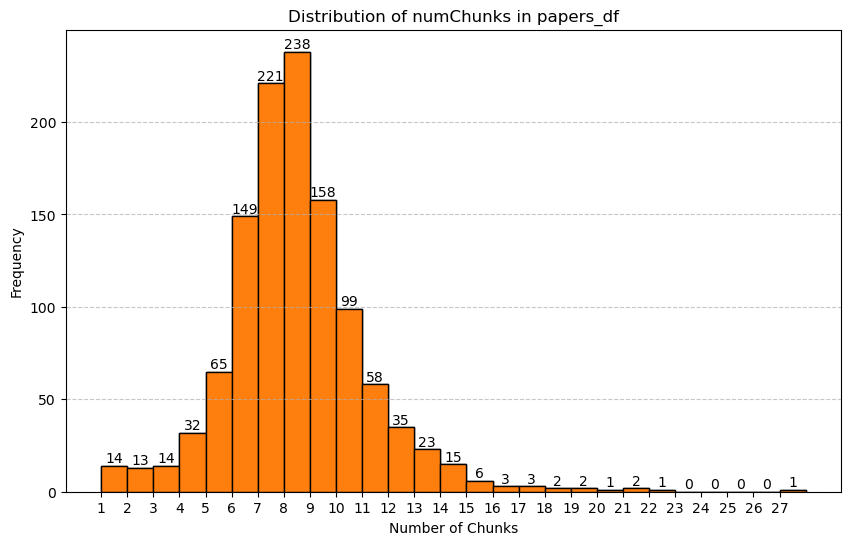

,numChunks,Frequency
0,1,14
1,2,13
2,3,14
3,4,32
4,5,65
5,6,149
6,7,221
7,8,238
8,9,158
9,10,99


In [25]:
# Plotting the distribution of 'numChunks'
plt.figure(figsize=(10, 6))
bars = plt.hist(papers_df['numChunks'], bins=range(1, max(papers_df['numChunks']) + 2), edgecolor='black')

# Adding numbers above each bar
for bar in bars[2]:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2.0, height, f'{int(height)}', ha='center', va='bottom')

plt.hist(papers_df['numChunks'], bins=range(1, max(papers_df['numChunks']) + 2), edgecolor='black')
plt.xlabel('Number of Chunks')
plt.ylabel('Frequency')
plt.title('Distribution of numChunks in papers_df')
plt.xticks(range(1, max(papers_df['numChunks']) + 1))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Calculating the frequency of each numChunks value
frequency_table = papers_df['numChunks'].value_counts().sort_index().reset_index()
frequency_table.columns = ['numChunks', 'Frequency']
frequency_table

In [11]:
#Get a list of lists corresponding to the chunks of each paper
chunks_list2 = []
for index, row in papers_df.iterrows():
    text = row["cleaned_content_text_noRefs"]
    chunks = split_text(text)
    chunks_list.append(chunks)
papers_df["chunks2"] = chunks_list
# 'numChunks' = len('chunks')
papers_df['numChunks2'] = papers_df['chunks2'].apply(len)

#Single list with all chunks merged in a single list disregarding the paper they came from
final_chunks_list = [p for p_list in papers_df["chunks2"] for p in p_list]

papers_df

ValueError: Length of values (2312) does not match length of index (1156)

In [22]:
papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_content_v4.csv', index=False, encoding='utf-8' )
papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,cleaned_content_text_noRefs
0,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383,[jul multidisciplinary open access archive dep...,12,jul multidisciplinary open access archive depo...
1,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192,[jan multidisciplinary open access archive dep...,12,jan multidisciplinary open access archive depo...
2,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071,[ecology letter reduced phenotypic plasticity ...,1,ecology letter reduced phenotypic plasticity e...
3,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338,[aug multidisciplinary open access archive dep...,7,aug multidisciplinary open access archive depo...
4,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648,[author posting sol trisos múrria jeliazkov go...,7,author posting sol trisos múrria jeliazkov gon...
...,...,...,...,...,...,...,...,...
1150,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000,[jun multidisciplinary open access archive dep...,7,jun multidisciplinary open access archive depo...
1151,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000,[oct multidisciplinary open access archive dep...,2,oct multidisciplinary open access archive depo...
1152,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000,[data set nitrogen carbon stable isotope tuna ...,1,data set nitrogen carbon stable isotope tuna n...
1153,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000,[jul multidisciplinary open access archive dep...,3,jul multidisciplinary open access archive depo...


# Implementation

In [11]:
from bertopic.representation import KeyBERTInspired
from bertopic import BERTopic

# Create your representation model
representation_model = KeyBERTInspired()

# Use the representation model in BERTopic on top of the default pipeline
topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model)
topics, probabilities = topic_model.fit_transform(final_chunks_list)

KeyboardInterrupt: 

In [44]:
topics

[31,
 2,
 -1,
 79,
 79,
 18,
 79,
 -1,
 79,
 79,
 79,
 79,
 -1,
 -1,
 79,
 79,
 79,
 79,
 -1,
 -1,
 -1,
 79,
 -1,
 79,
 79,
 -1,
 -1,
 214,
 -1,
 214,
 -1,
 -1,
 297,
 -1,
 214,
 42,
 214,
 214,
 214,
 214,
 214,
 214,
 20,
 214,
 214,
 20,
 -1,
 214,
 -1,
 214,
 -1,
 -1,
 91,
 -1,
 -1,
 -1,
 214,
 -1,
 -1,
 41,
 337,
 337,
 337,
 -1,
 -1,
 -1,
 337,
 337,
 337,
 337,
 337,
 337,
 337,
 337,
 22,
 -1,
 -1,
 -1,
 22,
 510,
 -1,
 63,
 -1,
 417,
 417,
 22,
 467,
 -1,
 1,
 56,
 -1,
 56,
 -1,
 56,
 56,
 56,
 1,
 2,
 2,
 342,
 -1,
 342,
 342,
 342,
 342,
 342,
 342,
 342,
 342,
 342,
 342,
 342,
 342,
 342,
 342,
 1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 118,
 -1,
 118,
 118,
 -1,
 -1,
 325,
 118,
 118,
 118,
 118,
 118,
 118,
 118,
 8,
 1,
 365,
 365,
 365,
 7,
 365,
 365,
 365,
 365,
 0,
 0,
 0,
 0,
 365,
 365,
 365,
 365,
 365,
 365,
 365,
 1,
 -1,
 38,
 -1,
 12,
 61,
 12,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 470,
 12,
 470,
 3

In [45]:
probabilities

array([[8.35859644e-307, 1.80911218e-306, 1.82878290e-306, ...,
        1.53214975e-306, 6.29368545e-307, 7.63593905e-307],
       [1.57644817e-003, 5.09976341e-003, 1.06872038e-001, ...,
        4.76962276e-003, 1.97172936e-003, 1.72073119e-003],
       [2.32166780e-004, 1.93761164e-004, 2.12291285e-004, ...,
        2.39492563e-004, 1.16231422e-004, 1.60574153e-004],
       ...,
       [6.30140790e-004, 3.32391427e-004, 3.37656650e-004, ...,
        3.43145271e-004, 2.71682521e-004, 1.07735106e-003],
       [1.72833226e-003, 6.76176676e-002, 6.00319663e-003, ...,
        2.99501225e-003, 2.01014660e-003, 2.00186786e-003],
       [2.42451554e-004, 4.72383300e-004, 5.57602116e-004, ...,
        4.31451127e-004, 3.10882796e-004, 2.57405031e-004]])

In [46]:
# Save the model
model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_keybert"
topic_model.save(model_save_path)

2024-05-30 16:33:29,530 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


In [47]:
updated_papers_df = get_topic_per_chunk(papers_df, topics)

In [49]:
updated_papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,Chunks_BERTopics
776,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383,[HAL Id : hal-03222436 https : //hal.inrae.fr/...,26,"[37, 64, -1, 37, 37, -1, -1, 37, 37, 37, 497, ..."
740,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192,[HAL Id : hal-00722758 https : //hal.science/h...,31,"[1, 231, 231, 231, 231, 231, 231, 231, 231, 23..."
422,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071,[Ecology Letters Reduced phenotypic plasticity...,2,"[-1, 151, 151, 151, 25, 151, 151, 151, 69, 151]"
278,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338,[HAL Id : hal-03321017 https : //hal.science/h...,15,"[461, 461, 461, 461, 461, -1, 461, 330, 461, 4..."
234,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648,"[Author Posting . © D. Sol , C. Trisos , C. Mú...",14,"[-1, -1, -1, 160, -1, -1, -1, 30, 30, -1, -1, ..."
...,...,...,...,...,...,...,...,...
431,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000,[HAL Id : hal-01335885 https : //hal.science/h...,15,"[-1, 54, 54, 54, 54, 30, -1, -1, 52, 54, -1, 2..."
249,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000,[HAL Id : hal-03813747 https : //hal.science/h...,5,"[1, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13..."
257,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000,[Global data set for nitrogen and carbon stabl...,2,"[-1, 506, 506, 506, 506, 506, 506, 506, 506, 5..."
280,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000,[HAL Id : hal-04164752 https : //hal.science/h...,7,"[-1, -1, 265, 3, 265, 265, 265, 265, 265, 265,..."


In [48]:
# Count the number of topics per document and examine the distribution
num_topics_per_doc = papers_df['Chunks_BERTopics'].apply(lambda x: len(x))
num_topics_distribution = num_topics_per_doc.value_counts().sort_index()

print("Distribution of the number of topics per document:")
print(num_topics_distribution)

# This can help identify if there are indeed documents with multiple topics that might have been overlooked, or confirm that the topic modeling process is resulting in a single dominant topic per document.
plt.figure(figsize=(10, 6))
num_topics_distribution.plot(kind='bar')
plt.title('Distribution of the Number of Topics per Document')
plt.xlabel('Number of Topics')
plt.ylabel('Number of Documents')
plt.xticks(rotation=45)  # Rotate labels to make them readable
plt.grid(axis='y', linestyle='--', linewidth=0.7)
plt.show()

TypeError: object of type 'NoneType' has no len()

In [51]:

# Get an overview of the topics
data = []
topics_overview = topic_model.get_topics()
num_topics = len(topics_overview)
print(num_topics)
for topic, words_probs in topics_overview.items():
    # Extract words and their probabilities into separate lists
    words, probs = zip(*words_probs[:10])  # Adjust the slice as needed

    # Append the data for this topic to the list
    data.append({
        "Topic": f"Topic {topic}",
        "Words": words,  # Convert words to a list
        "Probabilities": probs  # Convert probabilities to a list
    })

# Create DataFrame
topics_df = pd.DataFrame(data)
topics_df

536


,Topic,Words,Probabilities
0,Topic -1,"(ecology, traits, species, populations, trait,...","(0.4860731, 0.4120262, 0.3838819, 0.37546337, ..."
1,Topic 0,"(litter, litters, decomposers, biomass, decomp...","(0.49817902, 0.47121197, 0.39015043, 0.3593855..."
2,Topic 1,"(ecology, ecologie, scientifiques, evolution, ...","(0.51456416, 0.39898947, 0.34410822, 0.2761514..."
3,Topic 2,"(ecology, zoology, biodiversity, biological, b...","(0.38800013, 0.36684817, 0.3543082, 0.3248749,..."
4,Topic 3,"(virulence, parasites, parasite, infectious, v...","(0.5672017, 0.49938175, 0.49459118, 0.4350401,..."
...,...,...,...
531,Topic 530,"(phenotypic, traits, dragonflies, larvae, larv...","(0.45646578, 0.4001824, 0.38263327, 0.37827316..."
532,Topic 531,"(phylogenetic, traits, trait, niche, aquatic, ...","(0.4914647, 0.42753094, 0.40672836, 0.38614917..."
533,Topic 532,"(taxonomic, taxon, nomenclature, genus, subgen...","(0.65781975, 0.5734749, 0.55366147, 0.54615235..."
534,Topic 533,"(species, populations, biotypes, genetic, biot...","(0.4916495, 0.3820728, 0.37685326, 0.36406276,..."


In [52]:
topics_df.to_csv('topics_BERTopic_keybert_v1_535.csv',sep='\t', index=False, encoding='utf-8' )

In [56]:
topic_model.visualize_topics()

In [53]:
topic_model.visualize_hierarchy()

In [54]:
topic_model.visualize_heatmap()

In [57]:
topic_model.visualize_barchart()

In [59]:
topic_model.visualize_documents(final_chunks_list)

KeyboardInterrupt: 

In [ ]:
topic_model.visualize_documents(updated_papers_df['content_text_noRefs'])

## BERTopic KeyBERT 

top_n_words¶
top_n_words refers to the number of words per topic that you want to be extracted. In practice, I would advise you to keep this value below 30 and preferably between 10 and 20. The reasoning for this is that the more words you put in a topic the less coherent it can become. The top words are the most representative of the topic and should be focused on.

n_gram_range¶
The n_gram_range parameter refers to the CountVectorizer used when creating the topic representation. It relates to the number of words you want in your topic representation. For example, "New" and "York" are two separate words but are often used as "New York" which represents an n-gram of 2. Thus, the n_gram_range should be set to (1, 2) if you want "New York" in your topic representation.

min_topic_size¶
min_topic_size is an important parameter! It is used to specify what the minimum size of a topic can be. The lower this value the more topics are created. If you set this value too high, then it is possible that simply no topics will be created! Set this value too low and you will get many microclusters.

### BT6 : top_n_words=15

A) Loading an existing model

In [33]:
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired
from bertopic import BERTopic

# Create your representation model
representation_model = KeyBERTInspired()
# Load the saved BERTopic model
model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_keybert_top-w-15_min-ts50"
topic_model = BERTopic.load(model_save_path)



# Transform the new documents to get their topic distributions
topics, probs = topic_model.transform(final_chunks_list)

print("Topics:", topics)
print("Probabilities:", probs)


Topics: [60, 14, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, -1, 2, 2, 2, 2, -1, 2, 2, 2, -1, 2, 2, 7, 40, -1, -1, -1, -1, 0, -1, -1, -1, 1, -1, -1, -1, -1, -1, -1, 32, -1, -1, 32, 40, -1, 40, -1, -1, 0, 46, -1, 40, -1, -1, -1, -1, 61, -1, -1, -1, 37, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 43, 43, -1, 43, 43, -1, 1, 1, -1, 1, -1, 43, -1, 43, 5, 3, -1, 3, 1, 3, 3, 3, 5, 14, 14, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 5, 49, 3, 3, -1, 3, 3, 33, 33, 33, -1, -1, -1, 3, 3, 3, 3, -1, 1, -1, 1, 1, -1, -1, -1, 1, 1, 1, 1, 1, 1, 1, 11, 5, -1, -1, -1, 22, -1, -1, -1, -1, 6, 6, 6, 6, -1, -1, -1, -1, -1, -1, -1, 5, 17, 17, 17, 30, 17, 30, -1, -1, -1, -1, 17, -1, -1, -1, 17, -1, 17, 30, 17, 17, 30, 5, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11, -1, -1, 2, -1, -1, -1, -1, 11, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 11, 60, -1, 2, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 8, 8, 8, 8, 8, 8, 8, 35, 8, -1, 8, 8, 8, 8, 8, 1, -1, 1, 28, 28, -

B) Training model

In [32]:
from bertopic.representation import KeyBERTInspired
from bertopic import BERTopic

# Create your representation model
representation_model = KeyBERTInspired()

topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model, top_n_words=15,  min_topic_size=50)
topics, probabilities = topic_model.fit_transform(final_chunks_list)


KeyboardInterrupt: 

#### Results

In [34]:
# Get an overview of the topics
data = []
topics_overview = topic_model.get_topics()
num_topics = len(topics_overview)
print(num_topics)
for topic, words_probs in topics_overview.items():
    # Extract words and their probabilities into separate lists
    words, probs = zip(*words_probs[:10])  # Adjust the slice as needed

    # Append the data for this topic to the list
    data.append({
        "Topic": f"Topic {topic}",
        "Words": words,  # Convert words to a list
        "Probabilities": probs  # Convert probabilities to a list
    })

# Create DataFrame
topics_df = pd.DataFrame(data)
topics_df

67


,Topic,Words,Probabilities
0,Topic -1,"(ecology, species, habitat, populations, diver...","(0.5581909, 0.4639312, 0.44343567, 0.37826908,..."
1,Topic 0,"(haplotypes, genetic, populations, genome, spe...","(0.449197, 0.41499037, 0.4010604, 0.36966717, ..."
2,Topic 1,"(ecological, species, traits, phylogenetic, di...","(0.52847743, 0.43732333, 0.43115097, 0.4165867..."
3,Topic 2,"(forests, vegetation, trees, forest, ecology, ...","(0.514922, 0.5002304, 0.48113412, 0.4659684, 0..."
4,Topic 3,"(dispersal, species, habitat, populations, phe...","(0.71800125, 0.47493413, 0.43876746, 0.4312565..."
...,...,...,...
62,Topic 61,"(seabirds, seabird, birds, ecology, bird, bree...","(0.5112036, 0.45276326, 0.4398298, 0.39690638,..."
63,Topic 62,"(epigenetic, epigenetics, methylation, genes, ...","(0.5412456, 0.53814113, 0.45328796, 0.41088724..."
64,Topic 63,"(owls, predation, owl, breeding, reproduction,...","(0.5309645, 0.49064198, 0.43698534, 0.4240296,..."
65,Topic 64,"(sapotaceae, seeds, dispersal, myristicaceae, ...","(0.5250064, 0.480075, 0.43995118, 0.433352, 0...."


In [35]:
updated_papers_df = get_topic_per_chunk(papers_df, topics)
updated_papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,cleaned_content_text_noRefs,Chunks_BERTopics
0,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383,[HAL Id : hal-03222436 https : //hal.inrae.fr/...,26,jul multidisciplinary open access archive depo...,"[60, 14, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, -1, ..."
1,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192,[HAL Id : hal-00722758 https : //hal.science/h...,31,jan multidisciplinary open access archive depo...,"[40, -1, -1, -1, -1, 0, -1, -1, -1, 1, -1, -1,..."
2,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071,[Ecology Letters Reduced phenotypic plasticity...,2,ecology letter reduced phenotypic plasticity e...,"[-1, -1]"
3,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338,[HAL Id : hal-03321017 https : //hal.science/h...,15,aug multidisciplinary open access archive depo...,"[61, -1, -1, -1, 37, -1, -1, -1, -1, -1, -1, -..."
4,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648,"[Author Posting . © D. Sol , C. Trisos , C. Mú...",14,author posting sol trisos múrria jeliazkov gon...,"[43, 43, -1, 43, 43, -1, 1, 1, -1, 1, -1, 43, ..."
...,...,...,...,...,...,...,...,...,...
1150,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000,[HAL Id : hal-01335885 https : //hal.science/h...,15,jun multidisciplinary open access archive depo...,"[-1, 6, 6, 6, 6, -1, 6, 2, 6, 6, -1, 6, 6, -1, 6]"
1151,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000,[HAL Id : hal-03813747 https : //hal.science/h...,5,oct multidisciplinary open access archive depo...,"[5, 14, 14, -1, 11]"
1152,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000,[Global data set for nitrogen and carbon stabl...,2,data set nitrogen carbon stable isotope tuna n...,"[-1, -1]"
1153,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000,[HAL Id : hal-04164752 https : //hal.science/h...,7,jul multidisciplinary open access archive depo...,"[-1, -1, -1, -1, -1, -1, -1]"


In [36]:
topic_model.visualize_barchart()

In [37]:
topic_model.visualize_topics()


In [38]:
topic_model.visualize_hierarchy()


In [39]:
topic_model.visualize_heatmap()

Saving files

In [68]:
model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_keybert_top-w-15_min-ts50"
topic_model.save(model_save_path)

2024-05-30 20:25:20,554 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


In [72]:
topics_df.to_csv('topics_BERTopic_v6_67.csv',sep='\t', index=False, encoding='utf-8' )


In [40]:
updated_papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/BERT_topics/papers_BERTopic_v6_bt_keybert_top-w-15_min-ts50.csv', index=False, encoding='utf-8' )

### BT7 : top_n_words=20

In [73]:
topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model, top_n_words=20,  min_topic_size=50)
topics, probabilities = topic_model.fit_transform(final_chunks_list)


In [74]:
# Get an overview of the topics
data = []
topics_overview = topic_model.get_topics()
num_topics = len(topics_overview)
print(num_topics)
for topic, words_probs in topics_overview.items():
    # Extract words and their probabilities into separate lists
    words, probs = zip(*words_probs[:10])  # Adjust the slice as needed

    # Append the data for this topic to the list
    data.append({
        "Topic": f"Topic {topic}",
        "Words": words,  # Convert words to a list
        "Probabilities": probs  # Convert probabilities to a list
    })

# Create DataFrame
topics_df = pd.DataFrame(data)
topics_df

65


,Topic,Words,Probabilities
0,Topic -1,"(ecology, species, habitat, populations, envir...","(0.574119, 0.4645488, 0.412288, 0.38530383, 0...."
1,Topic 0,"(breeding, reproduction, demographic, reproduc...","(0.49211866, 0.40521723, 0.37850353, 0.3510141..."
2,Topic 1,"(genetic, haplotypes, populations, haplotype, ...","(0.47175187, 0.4221124, 0.40292448, 0.38467148..."
3,Topic 2,"(forests, forest, vegetation, trees, ecology, ...","(0.55110556, 0.50009537, 0.48814112, 0.4853629..."
4,Topic 3,"(dispersal, traits, species, trait, niche, ger...","(0.45470092, 0.45239556, 0.43144226, 0.3973368..."
...,...,...,...
60,Topic 59,"(epigenetic, epigenetics, methylation, genes, ...","(0.5412456, 0.53814113, 0.45328796, 0.41088724..."
61,Topic 60,"(seabird, birds, ecology, bird, breeding, hal,...","(0.45276326, 0.43982983, 0.39690638, 0.3940355..."
62,Topic 61,"(psi2, psi1, psi3, evolution, 1phi, ecology, 1...","(0.5399034, 0.5063697, 0.4820336, 0.19667032, ..."
63,Topic 62,"(dispersal, mating, moth, populations, predato...","(0.4396826, 0.43307322, 0.4061206, 0.34761068,..."


In [75]:
topic_model.visualize_barchart()

In [78]:
updated_papers_df = get_topic_per_chunk(papers_df, topics)
updated_papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,Chunks_BERTopics
776,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383,[HAL Id : hal-03222436 https : //hal.inrae.fr/...,26,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
740,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192,[HAL Id : hal-00722758 https : //hal.science/h...,31,"[4, -1, -1, -1, -1, -1, -1, -1, -1, -1, 27, -1..."
422,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071,[Ecology Letters Reduced phenotypic plasticity...,2,"[4, -1, -1, -1, 3, -1, -1, -1, -1, -1]"
278,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338,[HAL Id : hal-03321017 https : //hal.science/h...,15,"[-1, -1, -1, -1, -1, 20, -1, -1, -1, -1, -1, -..."
234,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648,"[Author Posting . © D. Sol , C. Trisos , C. Mú...",14,"[17, 17, 17, 17, 17, -1, 17, 1, 1, -1, 17, 17,..."
...,...,...,...,...,...,...,...,...
431,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000,[HAL Id : hal-01335885 https : //hal.science/h...,15,"[-1, 1, 1, 1, 1, 1, 1, 46, 1, 1, 1, 27, 0, 1, ..."
249,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000,[HAL Id : hal-03813747 https : //hal.science/h...,5,"[4, 48, -1, 48, 48, 48, 48, 48, 48, 48, 48, 48..."
257,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000,[Global data set for nitrogen and carbon stabl...,2,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]"
280,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000,[HAL Id : hal-04164752 https : //hal.science/h...,7,"[-1, 53, -1, 23, -1, -1, -1, -1, -1, -1, -1, -..."


In [83]:
topic_model.visualize_topics()


In [1]:
topic_model.visualize_heatmap()

NameError: name 'topic_model' is not defined

In [6]:
#model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_keybert_top-w-20_min-ts50"
#topic_model.save(model_save_path)


In [81]:
topics_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/topics_BERTopic_v7_65.csv',sep='\t', index=False, encoding='utf-8' )
updated_papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_BERTopic_v7_bt_keybert_top-w-20_min-ts50.csv',sep='\t', index=False, encoding='utf-8' )

## BERTopic MaximalMarginalRelevance 

When we calculate the weights of keywords, we typically do not consider whether we already have similar keywords in our topic. Words like "car" and "cars" essentially represent the same information and often redundant.

To decrease this redundancy and improve the diversity of keywords, we can use an algorithm called Maximal Marginal Relevance (MMR). MMR considers the similarity of keywords/keyphrases with the document, along with the similarity of already selected keywords and keyphrases. This results in a selection of keywords that maximize their within diversity with respect to the document.

### diversity=0.3, top_n_words=15,  min_topic_size=50

In [12]:
from bertopic.representation import MaximalMarginalRelevance
# Create your representation model
representation_model = MaximalMarginalRelevance(diversity=0.3)
topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model, top_n_words=15,  min_topic_size=50)
topics, probabilities = topic_model.fit_transform(final_chunks_list)

In [14]:

def get_topics_overview(topic_model, top_n_words=10):
    """
    Get an overview of the topics from a BERTopic model and return it as a DataFrame.

    Parameters:
    - topic_model: The trained BERTopic model.
    - top_n_words: The number of top words to include for each topic. Default is 10.

    Returns:
    - A DataFrame containing the topics, words, and their probabilities.
    """
    data = []
    topics_overview = topic_model.get_topics()
    num_topics = len(topics_overview)
    print(f"Number of topics: {num_topics}")

    for topic, words_probs in topics_overview.items():
        # Extract words and their probabilities into separate lists
        words, probs = zip(*words_probs[:top_n_words])  # Adjust the slice as needed

        # Append the data for this topic to the list
        data.append({
            "Topic": f"Topic {topic}",
            "Words": list(words),  # Convert words to a list
            "Probabilities": list(probs)  # Convert probabilities to a list
        })

    # Create DataFrame
    topics_df = pd.DataFrame(data)
    return topics_df


topics_df = get_topics_overview(topic_model, top_n_words=15)
topics_df

Number of topics: 67


,Topic,Words,Probabilities
0,Topic -1,"[of, et, al, species, we, were, at, between, d...","[0.012509945190505679, 0.009191422378797231, 0..."
1,Topic 0,"[genetic, loci, from, populations, et, samples...","[0.014930030932130094, 0.010335845201666116, 0..."
2,Topic 1,"[forest, tree, forests, al, trees, growth, mod...","[0.024419745964369834, 0.01590903482749539, 0...."
3,Topic 2,"[dispersal, species, climate, range, invasion,...","[0.025615063502967404, 0.012536495009489945, 0..."
4,Topic 3,"[survival, age, breeding, probabilities, popul...","[0.021057750123752588, 0.020568534431081902, 0..."
...,...,...,...
62,Topic 61,"[epigenetic, methylation, epigenetics, phenoty...","[0.08585764803962098, 0.06237580790561824, 0.0..."
63,Topic 62,"[pallida, isolates, virulence, infestans, nema...","[0.023017794969508884, 0.02256098258002247, 0...."
64,Topic 63,"[des, research, archive, forest, tree, ecology...","[0.028459642442896463, 0.026211601509063036, 0..."
65,Topic 64,"[phyllonorycter, sonchus, oleraceus, carpodacu...","[0.05002634951273754, 0.02252935431969629, 0.0..."


In [18]:
updated_papers_df = get_topic_per_chunk(papers_df, topics)
updated_papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,Chunks_BERTopics
776,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383,[HAL Id : hal-03222436 https : //hal.inrae.fr/...,26,"[60, 3, 3, 60, 60, -1, 3, 60, 60, 60, 3, 60, 3..."
740,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192,[HAL Id : hal-00722758 https : //hal.science/h...,31,"[6, 1, 1, 1, 1, 1, 1, 1, 1, 1, -1, 1, 1, 1, 1,..."
422,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071,[Ecology Letters Reduced phenotypic plasticity...,2,"[6, 62, 62, 62, 23, 62, 62, 62, 62, 62]"
278,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338,[HAL Id : hal-03321017 https : //hal.science/h...,15,"[-1, -1, -1, -1, -1, 19, -1, -1, -1, -1, -1, -..."
234,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648,"[Author Posting . © D. Sol , C. Trisos , C. Mú...",14,"[15, 15, 15, 15, 15, -1, 15, 0, 0, -1, 15, 15,..."
...,...,...,...,...,...,...,...,...
431,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000,[HAL Id : hal-01335885 https : //hal.science/h...,15,"[-1, 0, 0, 0, 0, 0, 0, 43, 0, 0, 0, 30, -1, 0,..."
249,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000,[HAL Id : hal-03813747 https : //hal.science/h...,5,"[6, 35, 19, 35, 35, 35, 35, 35, 35, 35, 35, 35..."
257,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000,[Global data set for nitrogen and carbon stabl...,2,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]"
280,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000,[HAL Id : hal-04164752 https : //hal.science/h...,7,"[13, 50, -1, 14, -1, -1, -1, -1, -1, -1, -1, -..."


In [15]:
def visualize_topic_model(topic_model):
    """
    Generate and display visualizations for the given BERTopic model.
    If a visualization fails, skip it and print the error.

    Parameters:
    - topic_model: The trained BERTopic model.
    """
    visualizations = {
        "Barchart": topic_model.visualize_barchart,
        "Topics": topic_model.visualize_topics,
        "Heatmap": topic_model.visualize_heatmap
    }

    for name, visualization in visualizations.items():
        try:
            print(f"Generating {name} visualization...")
            visualization().show()
        except Exception as e:
            print(f"Failed to generate {name} visualization: {e}")


visualize_topic_model(topic_model)


Generating Barchart visualization...


Generating Topics visualization...


Generating Heatmap visualization...


In [19]:
topics_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/topics_BERTopic_v8_67.csv',sep='\t', index=False, encoding='utf-8' )
updated_papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_BERTopic_v8_bt_mmr_top-w-15_min-ts50.csv',sep='\t', index=False, encoding='utf-8' )

### diversity=0.3, top_n_words=15, min_topic_size=100

In [20]:
representation_model = MaximalMarginalRelevance(diversity=0.3)
topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model, top_n_words=15,  min_topic_size=50)
topics, probabilities = topic_model.fit_transform(final_chunks_list)

topics_df = get_topics_overview(topic_model, top_n_words=15)
updated_papers_df = get_topic_per_chunk(papers_df, topics)

visualize_topic_model(topic_model)

Number of topics: 62
Generating Barchart visualization...


Generating Topics visualization...


Generating Heatmap visualization...


In [21]:
topics_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/topics_BERTopic_v9_67.csv',sep='\t', index=False, encoding='utf-8' )
updated_papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_BERTopic_v9_bt_mmr_top-w-15_min-ts100.csv',sep='\t', index=False, encoding='utf-8' )
model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_mmr_top-w-15_min-ts100-div3"
topic_model.save(model_save_path)

2024-06-03 11:57:44,446 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


## Zero-shot 

In [22]:
from bertopic.representation import ZeroShotClassification


# Create your representation model
candidate_topics = ["Evolutionary ecology", "Behavioral Ecology" ,"Chemical ecology", "Ecosystem functioning" , "Population dynamics"  , 
"Climate Change", "Conservation",          "CommunityEcology" ,"Ecology of interactions", "Biodiversity",
"Biostatistics", "Landscape Ecology","Spatial Ecology","Taxonomy Phylogeny"    , "Management"    , "Physiology" ,     
"Epidemiology", "Theoretical Ecology", "Evolution" ,    "Genetics"      ]

representation_model = ZeroShotClassification(candidate_topics, model="facebook/bart-large-mnli")


config.json:   0%|          | 0.00/1.15k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.63G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

In [23]:
topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model, top_n_words=15,  min_topic_size=50)
topics, probabilities = topic_model.fit_transform(final_chunks_list)

topics_df = get_topics_overview(topic_model, top_n_words=15)
updated_papers_df = get_topic_per_chunk(papers_df, topics)

visualize_topic_model(topic_model)

Number of topics: 70
Generating Barchart visualization...


Generating Topics visualization...


Generating Heatmap visualization...


In [24]:
topics_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/topics_BERTopic_v10_70.csv',sep='\t', index=False, encoding='utf-8' )
updated_papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_BERTopic_v10_bt_zs_top-w-15_min-ts50.csv',sep='\t', index=False, encoding='utf-8' )
model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_bt_zs_top-w-15_min-ts50"
topic_model.save(model_save_path)

2024-06-03 13:16:15,117 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


## Multimodel

In [30]:
from bertopic.representation import KeyBERTInspired
from bertopic.representation import PartOfSpeech
from bertopic.representation import MaximalMarginalRelevance


# The main representation of a topic
main_representation = KeyBERTInspired()

# Additional ways of representing a topic
#aspect_model1 = PartOfSpeech("en_core_web_sm")
aspect_model2 = [KeyBERTInspired(top_n_words=15), MaximalMarginalRelevance(diversity=.3)]

# Add all models together to be run in a single `fit`
representation_model = {
   "Main": main_representation,
#   "Aspect1":  aspect_model1,
   "Aspect2":  aspect_model2 
}


In [31]:
topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model, top_n_words=15,  min_topic_size=50)
topics, probabilities = topic_model.fit_transform(final_chunks_list)

In [32]:
topics_df = get_topics_overview(topic_model, top_n_words=15)
updated_papers_df = get_topic_per_chunk(papers_df, topics)

visualize_topic_model(topic_model)

topics_df

Number of topics: 69
Generating Barchart visualization...


Generating Topics visualization...


Generating Heatmap visualization...


[58,
 10,
 3,
 3,
 3,
 14,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 -1,
 -1,
 3,
 3,
 -1,
 3,
 3,
 8,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 0,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 29,
 -1,
 -1,
 29,
 50,
 -1,
 50,
 -1,
 -1,
 -1,
 48,
 -1,
 50,
 -1,
 -1,
 -1,
 -1,
 56,
 -1,
 -1,
 -1,
 44,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 40,
 40,
 -1,
 40,
 40,
 -1,
 0,
 0,
 -1,
 0,
 0,
 40,
 -1,
 40,
 2,
 14,
 0,
 14,
 0,
 14,
 14,
 14,
 2,
 10,
 10,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 2,
 54,
 13,
 13,
 -1,
 13,
 13,
 30,
 30,
 30,
 -1,
 -1,
 -1,
 13,
 13,
 13,
 13,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 3,
 -1,
 -1,
 0,
 -1,
 -1,
 -1,
 24,
 2,
 -1,
 -1,
 -1,
 15,
 -1,
 -1,
 -1,
 -1,
 5,
 -1,
 5,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 -1,
 2,
 0,
 0,
 0,
 28,
 0,
 28,
 -1,
 -1,
 -1,
 -1,
 0,
 -1,
 -1,
 -1,
 0,
 -1,
 0,
 28,
 0,
 0,
 28,
 2,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 23,
 24,
 -1,
 

In [33]:
topics_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/topics_BERTopic_v11_70.csv',sep='\t', index=False, encoding='utf-8' )
updated_papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_BERTopic_v11_multi.csv',sep='\t', index=False, encoding='utf-8' )
model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_multi_kb_mmr_v11"
topic_model.save(model_save_path)

2024-06-03 18:24:31,621 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


## Multimodel 2

In [34]:
# The main representation of a topic
main_representation = KeyBERTInspired()

# Additional ways of representing a topic
#aspect_model1 = PartOfSpeech("en_core_web_sm")
aspect_model2 = MaximalMarginalRelevance(diversity=.3)

# Add all models together to be run in a single `fit`
representation_model = {
   "Main": main_representation,
#   "Aspect1":  aspect_model1,
   "Aspect2":  aspect_model2 
}

topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model, top_n_words=15,  min_topic_size=50)
topics, probabilities = topic_model.fit_transform(final_chunks_list)

In [35]:
topics_df = get_topics_overview(topic_model, top_n_words=15)
updated_papers_df = get_topic_per_chunk(papers_df, topics)

visualize_topic_model(topic_model)

topics_df

Number of topics: 74
Generating Barchart visualization...


Generating Topics visualization...


Generating Heatmap visualization...


,Topic,Words,Probabilities
0,Topic -1,"[ecology, species, habitat, populations, trait...","[0.54376477, 0.50441456, 0.47907126, 0.4761394..."
1,Topic 0,"[haplotypes, genetic, genome, haplotype, popul...","[0.4372608, 0.40589124, 0.39999807, 0.39891112..."
2,Topic 1,"[forests, forest, trees, vegetation, ecosystem...","[0.5510622, 0.51691544, 0.4770286, 0.46711236,..."
3,Topic 2,"[ecology, ecological, scientifiques, evolution...","[0.47677886, 0.46480894, 0.30903554, 0.2443883..."
4,Topic 3,"[litter, litters, ecosystem, decomposers, deco...","[0.51870626, 0.48805597, 0.41970855, 0.4079551..."
...,...,...,...
69,Topic 68,"[albatrosses, albatross, seabirds, foraging, s...","[0.537455, 0.51930547, 0.49496466, 0.4517931, ..."
70,Topic 69,"[virulence, virulent, pathogen, nematodes, par...","[0.43701145, 0.39744955, 0.39602304, 0.3551670..."
71,Topic 70,"[ecological, abundances, networks, communities...","[0.4818716, 0.4359802, 0.43186408, 0.4027017, ..."
72,Topic 71,"[seabird, birds, ecology, bird, breeding, hal,...","[0.4527633, 0.4398298, 0.39690638, 0.3940355, ..."


In [36]:
topics_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/topics_BERTopic_v12_74.csv',sep='\t', index=False, encoding='utf-8' )
updated_papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_BERTopic_v12_multi2.csv',sep='\t', index=False, encoding='utf-8' )
model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_multi_kb_mmr_v12"
topic_model.save(model_save_path)

2024-06-03 19:43:26,076 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


## ++ diversity 0.5

In [41]:
# The main representation of a topic
main_representation = KeyBERTInspired()

# Additional ways of representing a topic
#aspect_model1 = PartOfSpeech("en_core_web_sm")
aspect_model2 = MaximalMarginalRelevance(diversity=.5)

# Add all models together to be run in a single `fit`
representation_model = {
   "Main": main_representation,
#   "Aspect1":  aspect_model1,
   "Aspect2":  aspect_model2 
}

topic_model = BERTopic(language="english", calculate_probabilities=True, representation_model=representation_model, top_n_words=15,  min_topic_size=50)
topics, probabilities = topic_model.fit_transform(final_chunks_list)

topics_df = get_topics_overview(topic_model, top_n_words=15)
updated_papers_df = get_topic_per_chunk(papers_df, topics)

visualize_topic_model(topic_model)

topics_df

Number of topics: 73
Generating Barchart visualization...


Generating Topics visualization...


Generating Heatmap visualization...


,Topic,Words,Probabilities
0,Topic -1,"[ecology, species, habitat, populations, trait...","[0.513486, 0.42642, 0.413704, 0.40503883, 0.31..."
1,Topic 0,"[populations, genetic, haplotypes, haplotype, ...","[0.4568377, 0.45277447, 0.43148524, 0.3859442,..."
2,Topic 1,"[dispersal, species, habitat, populations, nic...","[0.72702646, 0.432638, 0.41998377, 0.3998974, ..."
3,Topic 2,"[forests, trees, vegetation, forest, tree, eco...","[0.5165813, 0.47820255, 0.4781549, 0.46338502,..."
4,Topic 3,"[recapture, breeding, demographic, mortality, ...","[0.43396112, 0.40259457, 0.37948596, 0.3754114..."
...,...,...,...
68,Topic 67,"[fisheries, ecology, trophic, fish, marine, co...","[0.4600448, 0.42362732, 0.3146276, 0.31177905,..."
69,Topic 68,"[psi2, psi1, psi3, evolution, 1phi, ecology, 1...","[0.5399035, 0.50636977, 0.48203364, 0.19667032..."
70,Topic 69,"[agromyzidae, species, aphididae, asteraceae, ...","[0.41778925, 0.40831456, 0.40706694, 0.3948652..."
71,Topic 70,"[parasitoids, parasitoid, extinction, hostpara...","[0.5456196, 0.5214763, 0.5142045, 0.45396918, ..."


In [43]:
topics_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/topics_BERTopic_v13_73.csv',sep='\t', index=False, encoding='utf-8' )
updated_papers_df.to_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/papers_BERTopic_v13_multi2.csv',sep='\t', index=False, encoding='utf-8' )
model_save_path = "C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/Bertopic_models/bt_multi_kb_mmr_v13"
topic_model.save(model_save_path)

2024-06-03 21:07:39,228 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


## BERTopic Parametrization Comparisons

In [42]:
file_path_7 = 'C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/BERT_topics/papers_BERTopic_v7_bt_keybert_top-w-20_min-ts50.csv'
file_path_6 = 'C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/BERT_topics/papers_BERTopic_v6_bt_keybert_top-w-15_min-ts50.csv'




papers_bt7 = pd.read_csv(file_path_7, encoding='utf-8')
papers_bt7 = papers_bt7[['fileMain_s', 'chunks', 'numChunks', 'Chunks_BERTopics']]

papers_bt6 = pd.read_csv(file_path_6,  encoding='utf-8')
papers_bt6 = papers_bt6[['fileMain_s', 'chunks','numChunks', 'Chunks_BERTopics']]

ParserError: Error tokenizing data. C error: Expected 1 fields in line 4, saw 2


In [48]:
file_path = 'C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/BERT_topics/papers_BERTopic_v6_bt_keybert_top-w-15_min-ts50.csv' 
papers_bt7 = pd.read_csv(file_path, encoding='utf-8')
papers_bt6 = pd.read_csv(file_path, encoding='utf-8')
papers_bt6

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,cleaned_content_text_noRefs,Chunks_BERTopics
0,https://hal.inrae.fr/hal-03222436/document,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,httpshalinraefrhal jul multidisciplinary open ...,HAL Id: hal-03222436 https://hal.inrae.fr/hal-...,58.418383,['HAL Id : hal-03222436 https : //hal.inrae.fr...,26,jul multidisciplinary open access archive depo...,"[60, 14, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, -1, ..."
1,https://hal.science/hal-00722758/document,HAL Id: hal-00722758 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-00722758 https://hal.science/hal-0...,57.506192,['HAL Id : hal-00722758 https : //hal.science/...,31,jan multidisciplinary open access archive depo...,"[40, -1, -1, -1, -1, 0, -1, -1, -1, 1, -1, -1,..."
2,https://hal.science/hal-02998161/document,Ecology Letters Reduced phenotypic plasticity ...,ecology letter reduced phenotypic plasticity e...,Ecology Letters Reduced phenotypic plasticity ...,56.844071,['Ecology Letters Reduced phenotypic plasticit...,2,ecology letter reduced phenotypic plasticity e...,"[-1, -1]"
3,https://hal.science/hal-03321017/document,HAL Id: hal-03321017 https://hal.science/hal-0...,httpshalsciencehal aug multidisciplinary open ...,HAL Id: hal-03321017 https://hal.science/hal-0...,56.638338,['HAL Id : hal-03321017 https : //hal.science/...,15,aug multidisciplinary open access archive depo...,"[61, -1, -1, -1, 37, -1, -1, -1, -1, -1, -1, -..."
4,https://hal.science/hal-02551964/document,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",author posting sol trisos múrria jeliazkov gon...,"Author Posting. © D. Sol, C. Trisos, C. Múrri...",54.070648,"[""Author Posting . © D. Sol , C. Trisos , C. M...",14,author posting sol trisos múrria jeliazkov gon...,"[43, 43, -1, 43, 43, -1, 1, 1, -1, 1, -1, 43, ..."
...,...,...,...,...,...,...,...,...,...
1150,https://hal.science/hal-01335885/document,HAL Id: hal-01335885 https://hal.science/hal-0...,httpshalsciencehal jun multidisciplinary open ...,HAL Id: hal-01335885 https://hal.science/hal-0...,0.000000,['HAL Id : hal-01335885 https : //hal.science/...,15,jun multidisciplinary open access archive depo...,"[-1, 6, 6, 6, 6, -1, 6, 2, 6, 6, -1, 6, 6, -1, 6]"
1151,https://hal.science/hal-03813747/document,HAL Id: hal-03813747 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-03813747 https://hal.science/hal-0...,0.000000,['HAL Id : hal-03813747 https : //hal.science/...,5,oct multidisciplinary open access archive depo...,"[5, 14, 14, -1, 11]"
1152,https://hal.science/hal-03203941/document,Global data set for nitrogen and carbon stable...,data set nitrogen carbon stable isotope tuna n...,Global data set for nitrogen and carbon stable...,0.000000,['Global data set for nitrogen and carbon stab...,2,data set nitrogen carbon stable isotope tuna n...,"[-1, -1]"
1153,https://hal.science/hal-04164752/document,HAL Id: hal-04164752 https://hal.science/hal-0...,httpshalsciencehal jul multidisciplinary open ...,HAL Id: hal-04164752 https://hal.science/hal-0...,0.000000,['HAL Id : hal-04164752 https : //hal.science/...,7,jul multidisciplinary open access archive depo...,"[-1, -1, -1, -1, -1, -1, -1]"


In [23]:
# Function to safely get the length of an item, returning None if the item is not a list
def safe_len(x):
    try:
        return len(x)
    except TypeError:
        return None

# Apply the function to both columns and identify problematic rows
try:
    papers_bt7['chunks_len'] = papers_bt7['chunks'].apply(safe_len)
    papers_bt7['Chunks_BERTopics_len'] = papers_bt7['Chunks_BERTopics'].apply(safe_len)
except TypeError as e:
    print("Error processing row:")
    print(e)

# Identify rows where lengths could not be calculated
invalid_rows = papers_bt7[papers_bt7['chunks_len'].isna() | papers_bt7['Chunks_BERTopics_len'].isna()]

# Print the invalid rows
print("Rows with invalid data:")
print(invalid_rows)

Rows with invalid data:
                                    fileMain_s  \
890  https://hal.science/hal-04305512/document   

                                                chunks  numChunks  \
890  ['HAL Id : hal-04305512 https : //hal.science/...         21   

    Chunks_BERTopics  chunks_len  Chunks_BERTopics_len  
890              NaN       55978                   NaN  


In [25]:
# Apply the function to both columns and identify problematic rows
try:
    papers_bt6['chunks_len'] = papers_bt6['chunks'].apply(safe_len)
    papers_bt6['Chunks_BERTopics_len'] = papers_bt6['Chunks_BERTopics'].apply(safe_len)
except TypeError as e:
    print("Error processing row:")
    print(e)
    
invalid_rows = papers_bt6[papers_bt6['chunks_len'].isna() | papers_bt6['Chunks_BERTopics_len'].isna()]

# Print the invalid rows
print("Rows with invalid data:")
print(invalid_rows)

Rows with invalid data:
                                    fileMain_s  \
890  https://hal.science/hal-04305512/document   

                                                chunks  numChunks  \
890  ['HAL Id : hal-04305512 https : //hal.science/...         21   

    Chunks_BERTopics  chunks_len  Chunks_BERTopics_len  
890              NaN       55978                   NaN  


In [18]:
papers_bt7[papers_bt7['numChunks']!=len(papers_bt7['Chunks_BERTopics'])]

,fileMain_s,numChunks,Chunks_BERTopics
0,https://hal.inrae.fr/hal-03222436/document,26,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,https://hal.science/hal-00722758/document,31,"[4, -1, -1, -1, -1, -1, -1, -1, -1, -1, 27, -1..."
2,https://hal.science/hal-02998161/document,2,"[4, -1, -1, -1, 3, -1, -1, -1, -1, -1]"
3,https://hal.science/hal-03321017/document,15,"[-1, -1, -1, -1, -1, 20, -1, -1, -1, -1, -1, -..."
4,https://hal.science/hal-02551964/document,14,"[17, 17, 17, 17, 17, -1, 17, 1, 1, -1, 17, 17,..."
...,...,...,...
1151,https://hal.science/hal-01335885/document,15,"[-1, 1, 1, 1, 1, 1, 1, 46, 1, 1, 1, 27, 0, 1, ..."
1152,https://hal.science/hal-03813747/document,5,"[4, 48, -1, 48, 48, 48, 48, 48, 48, 48, 48, 48..."
1153,https://hal.science/hal-03203941/document,2,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]"
1154,https://hal.science/hal-04164752/document,7,"[-1, 53, -1, 23, -1, -1, -1, -1, -1, -1, -1, -..."


In [17]:
papers_bt6[papers_bt6['numChunks']<1]

,fileMain_s,numChunks,Chunks_BERTopics
1148,https://ird.hal.science/ird-00195246/document,0,"[0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0]"


In [2]:
# Define a function to parse the string representation of the list and return a Counter dictionary
def parse_and_count_topics(topic_string):
    # Check if the topic_string is NaN
    if pd.isna(topic_string):
        return np.nan
    # Convert the string representation of a list to an actual list using ast.literal_eval
    topic_list = ast.literal_eval(topic_string)
    # Create a Counter dictionary from the list to count the occurrence of each topic
    topic_counter = Counter(f"B{topic}" for topic in topic_list)
    return dict(topic_counter)



In [29]:
# Apply the function to each row in the 'Chunks_BERTopics' column to create the new 'Parsed_BERTopics' column
papers_bt6['Parsed_BERTopics'] = papers_bt6['Chunks_BERTopics'].apply(parse_and_count_topics)
papers_bt7['Parsed_BERTopics'] = papers_bt7['Chunks_BERTopics'].apply(parse_and_count_topics)
papers_bt6

,fileMain_s,chunks,numChunks,Chunks_BERTopics,chunks_len,Chunks_BERTopics_len,Parsed_BERTopics
0,https://hal.inrae.fr/hal-03222436/document,['HAL Id : hal-03222436 https : //hal.inrae.fr...,26,"[63, 4, 4, 63, 63, -1, -1, 63, -1, 63, 4, -1, ...",74751,68.0,"{'B63': 10, 'B4': 4, 'B-1': 4}"
1,https://hal.science/hal-00722758/document,['HAL Id : hal-00722758 https : //hal.science/...,31,"[5, 2, 2, -1, 2, -1, 2, 2, 2, 2, -1, 2, 2, 2, ...",86945,72.0,"{'B5': 1, 'B2': 15, 'B-1': 5, 'B11': 1}"
2,https://hal.science/hal-02998161/document,['Ecology Letters Reduced phenotypic plasticit...,2,"[5, 10, 10, 10, -1, 10, 10, 10, -1, -1]",4726,39.0,"{'B5': 1, 'B10': 6, 'B-1': 3}"
3,https://hal.science/hal-03321017/document,['HAL Id : hal-03321017 https : //hal.science/...,15,"[-1, -1, -1, -1, -1, 19, -1, -1, -1, -1, -1, -...",43429,60.0,"{'B-1': 14, 'B19': 1}"
4,https://hal.science/hal-02551964/document,"[""Author Posting . © D. Sol , C. Trisos , C. M...",14,"[16, 16, 16, 16, 16, -1, 16, 0, 0, -1, 16, 16,...",40978,106.0,"{'B16': 18, 'B-1': 4, 'B0': 2, 'B32': 1, 'B55'..."
...,...,...,...,...,...,...,...
1151,https://hal.science/hal-01335885/document,['HAL Id : hal-01335885 https : //hal.science/...,15,"[-1, 0, 0, 0, 0, 0, 0, 40, 0, 0, 0, 32, -1, 0,...",41468,65.0,"{'B-1': 2, 'B0': 15, 'B40': 1, 'B32': 1, 'B11'..."
1152,https://hal.science/hal-03813747/document,['HAL Id : hal-03813747 https : //hal.science/...,5,"[5, 44, 19, 44, 44, 44, 44, 44, 44, 44, 44, 44...",12434,67.0,"{'B5': 1, 'B44': 14, 'B19': 1, 'B-1': 1}"
1153,https://hal.science/hal-03203941/document,['Global data set for nitrogen and carbon stab...,2,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]",4621,48.0,{'B-1': 12}
1154,https://hal.science/hal-04164752/document,['HAL Id : hal-04164752 https : //hal.science/...,7,"[-1, 49, -1, 10, -1, -1, -1, -1, -1, -1, -1, -...",19697,56.0,"{'B-1': 11, 'B49': 1, 'B10': 1, 'B38': 1}"


In [3]:
def calculate_percentage(counter_dict):
    #Will receive a row with Counters and provide its equivalent value as percentages
    # Check if the input is NaN
    if pd.isna(counter_dict):
        return np.nan
    # Calculate the total number of topics
    total = sum(counter_dict.values())
    # Calculate the percentage for each topic
    percentages = {key: (value / total) * 100 for key, value in counter_dict.items()}
    return percentages



In [53]:
papers_bt6['Parsed_BERTopics_percentage'] = papers_bt6['Parsed_BERTopics'].apply(calculate_percentage)
papers_bt7['Parsed_BERTopics_percentage'] = papers_bt7['Parsed_BERTopics'].apply(calculate_percentage)
papers_bt7

,fileMain_s,chunks,numChunks,Chunks_BERTopics,chunks_len,Chunks_BERTopics_len,Parsed_BERTopics,Parsed_BERTopics_percentage
0,https://hal.inrae.fr/hal-03222436/document,['HAL Id : hal-03222436 https : //hal.inrae.fr...,26,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",74751,54.0,{'B0': 18},{'B0': 100.0}
1,https://hal.science/hal-00722758/document,['HAL Id : hal-00722758 https : //hal.science/...,31,"[4, -1, -1, -1, -1, -1, -1, -1, -1, -1, 27, -1...",86945,86.0,"{'B4': 1, 'B-1': 19, 'B27': 1, 'B8': 1}","{'B4': 4.545454545454546, 'B-1': 86.3636363636..."
2,https://hal.science/hal-02998161/document,['Ecology Letters Reduced phenotypic plasticit...,2,"[4, -1, -1, -1, 3, -1, -1, -1, -1, -1]",4726,38.0,"{'B4': 1, 'B-1': 8, 'B3': 1}","{'B4': 10.0, 'B-1': 80.0, 'B3': 10.0}"
3,https://hal.science/hal-03321017/document,['HAL Id : hal-03321017 https : //hal.science/...,15,"[-1, -1, -1, -1, -1, 20, -1, -1, -1, -1, -1, -...",43429,60.0,"{'B-1': 14, 'B20': 1}","{'B-1': 93.33333333333333, 'B20': 6.6666666666..."
4,https://hal.science/hal-02551964/document,"[""Author Posting . © D. Sol , C. Trisos , C. M...",14,"[17, 17, 17, 17, 17, -1, 17, 1, 1, -1, 17, 17,...",40978,105.0,"{'B17': 18, 'B-1': 4, 'B1': 2, 'B27': 1, 'B39'...","{'B17': 66.66666666666666, 'B-1': 14.814814814..."
...,...,...,...,...,...,...,...,...
1151,https://hal.science/hal-01335885/document,['HAL Id : hal-01335885 https : //hal.science/...,15,"[-1, 1, 1, 1, 1, 1, 1, 46, 1, 1, 1, 27, 0, 1, ...",41468,63.0,"{'B-1': 1, 'B1': 15, 'B46': 1, 'B27': 1, 'B0':...","{'B-1': 5.0, 'B1': 75.0, 'B46': 5.0, 'B27': 5...."
1152,https://hal.science/hal-03813747/document,['HAL Id : hal-03813747 https : //hal.science/...,5,"[4, 48, -1, 48, 48, 48, 48, 48, 48, 48, 48, 48...",12434,67.0,"{'B4': 1, 'B48': 14, 'B-1': 1, 'B10': 1}","{'B4': 5.88235294117647, 'B48': 82.35294117647..."
1153,https://hal.science/hal-03203941/document,['Global data set for nitrogen and carbon stab...,2,"[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1]",4621,48.0,{'B-1': 12},{'B-1': 100.0}
1154,https://hal.science/hal-04164752/document,['HAL Id : hal-04164752 https : //hal.science/...,7,"[-1, 53, -1, 23, -1, -1, -1, -1, -1, -1, -1, -...",19697,56.0,"{'B-1': 11, 'B53': 1, 'B23': 1, 'B37': 1}","{'B-1': 78.57142857142857, 'B53': 7.1428571428..."


In [49]:
threshold = 50
count_bt6 = papers_bt6['Parsed_BERTopics_percentage'].apply(lambda x: x.get('B-1', 0) >= threshold if isinstance(x, dict) else False).sum()
print(f"Number of rows in papers_bt6 with 'B-1' having more than {threshold}%: {count_bt6}/{len(papers_bt6)}")

count_bt7 = papers_bt7['Parsed_BERTopics_percentage'].apply(lambda x: x.get('B-1', 0) >= threshold if isinstance(x, dict) else False).sum()
print(f"Number of rows in papers_bt7 with 'B-1' having more than {threshold}%: {count_bt7}/{len(papers_bt7)}")

Number of rows in papers_bt6 with 'B-1' having more than 50%: 555/1156
Number of rows in papers_bt7 with 'B-1' having more than 50%: 526/1156


In [68]:
# Define the thresholds
thresholds = [0,10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

# Function to count rows with 'B-1' having more than the threshold percentage
def count_above_threshold(df, threshold):
    return df['Parsed_BERTopics_percentage'].apply(
        lambda x: x.get('B1', 0) >= threshold if isinstance(x, dict) else False).sum()

# Create the outliers_count DataFrame
outliers_count = pd.DataFrame({
    'threshold': thresholds,
    'bt6': [count_above_threshold(papers_bt6, t) for t in thresholds],
    'bt7': [count_above_threshold(papers_bt7, t) for t in thresholds]
})

# Set 'threshold' as the index
outliers_count.set_index('threshold', inplace=True)

# Check if the sum of the columns in outliers_count gives the same values
sum_bt6 = outliers_count['bt6'].sum()
sum_bt7 = outliers_count['bt7'].sum()

print(f"Sum of 'bt6' column: {sum_bt6}")
print(f"Sum of 'bt7' column: {sum_bt7}")

if sum_bt6 == sum_bt7:
    print("The sums of the columns 'bt6' and 'bt7' are equal.")
else:
    print("The sums of the columns 'bt6' and 'bt7' are not equal.")
    
    
outliers_count

Sum of 'bt6' column: 1435
Sum of 'bt7' column: 1575
The sums of the columns 'bt6' and 'bt7' are not equal.


,bt6,bt7
threshold,,
0,1155,1155
10,86,103
20,56,73
30,42,60
40,33,50
50,24,45
60,18,33
70,11,27
80,7,19


In [69]:
row_number = sum(outliers_count['bt6'])
row_number

1435

<Figure size 1000x600 with 0 Axes>

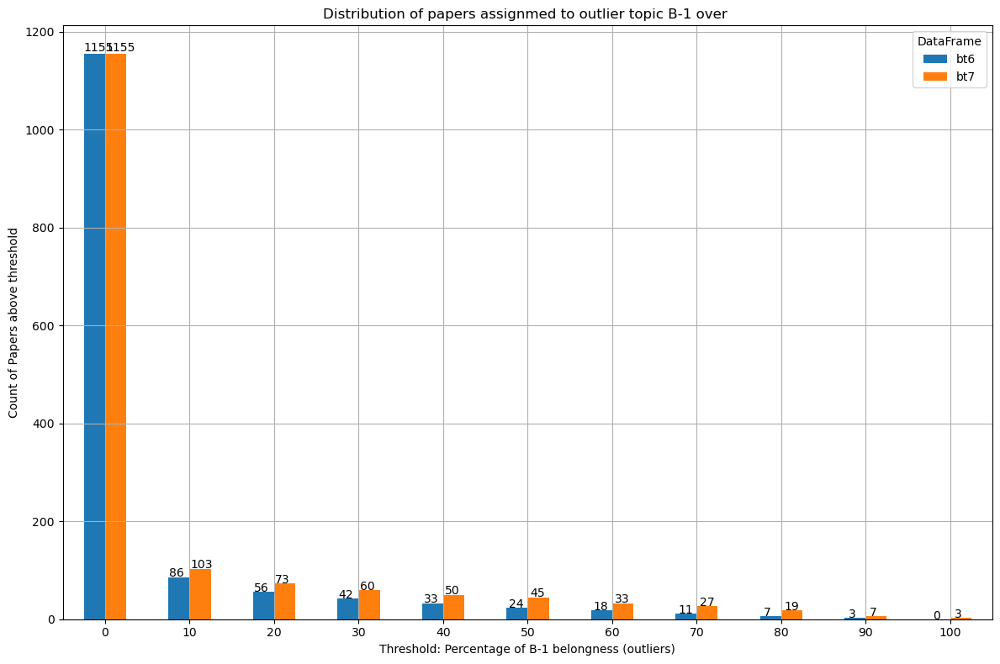

In [71]:
# Plot the distribution
plt.figure(figsize=(10, 6))
ax = outliers_count.plot(kind='bar', figsize=(12, 8))
plt.title(f'Distribution of papers assignmed to outlier topic B-1 over ')
plt.xlabel('Threshold: Percentage of B-1 belongness (outliers)')
plt.ylabel('Count of Papers above threshold')
plt.xticks(rotation=0)
plt.legend(title='DataFrame')
plt.grid(True)

# Add values above each bar
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.005, p.get_height() * 1.005))

plt.tight_layout()

# Show the plot
plt.show()

In [73]:

# Function to find documents containing specific terms
def find_documents_with_terms(df, terms):
    matching_docs = defaultdict(list)
    for index, row in df.iterrows():
        for term in terms:
            for chunk in row['chunks']:
                if term in chunk:
                    matching_docs[term].append(index)
                    break
    return matching_docs

# Terms to search for
terms_to_search = ['lm',  '0m7m1',  'l0','bm','uorb1','lv','m7v1r','uvb77','0bo7b']


# Find documents containing these terms
docs_with_terms = find_documents_with_terms(papers_bt6, terms_to_search)

print("Documents containing the specified terms:")
for term, doc_indices in docs_with_terms.items():
    print(f"Term '{term}' found in documents: {doc_indices}")
    
docs_with_terms

Documents containing the specified terms:


defaultdict(list, {})

In [77]:
count_bt6 = papers_bt6['Parsed_BERTopics_percentage'].apply(lambda x: x.get('B26', 0) >= 0 if isinstance(x, dict) else False).sum()
count_bt6

0

In [85]:
# Function to filter rows based on key and threshold
def filter_rows_by_key_threshold(df, column, key, threshold):
    # Apply the filter to get a boolean mask
    mask = df[column].apply(lambda x: x.get(key, 0) > threshold if isinstance(x, dict) else False)
    # Return the filtered DataFrame
    return df[mask]

# Define key and threshold
key = 'B26'
threshold = 0

# Get the rows where 'B26' has a value above the threshold
filtered_df = filter_rows_by_key_threshold(papers_bt6, 'Parsed_BERTopics_percentage', key, threshold)

# Extract and display only the 'B26' values from the 'Parsed_BERTopics_percentages' column
b26_values = filtered_df['Parsed_BERTopics_percentage'].apply(lambda x: x.get(key) if isinstance(x, dict) else np.nan)
print(b26_values)

218      5.555556
651     22.222222
696      4.000000
823      5.555556
910     99.115044
1027     5.263158
Name: Parsed_BERTopics_percentage, dtype: float64


In [86]:
filtered_df['fileMain_s']

,fileMain_s,chunks,numChunks,Chunks_BERTopics,chunks_len,Chunks_BERTopics_len,Parsed_BERTopics,Parsed_BERTopics_percentage
218,https://hal.science/hal-02268916/document,['HAL Id : hal-02268916 https : //hal.science/...,14,"[-1, -1, 3, 13, 3, 13, 13, 13, 13, 13, 13, 13,...",38209,70.0,"{'B-1': 2, 'B3': 2, 'B13': 12, 'B26': 1, 'B11'...","{'B-1': 11.11111111111111, 'B3': 11.1111111111..."
651,https://hal.science/hal-03892532/document,['HAL Id : hal-03892532 https : //hal.science/...,13,"[14, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -...",36701,72.0,"{'B14': 1, 'B-1': 13, 'B26': 4}","{'B14': 5.555555555555555, 'B-1': 72.222222222..."
696,https://hal.science/hal-01883365/document,['HAL Id : hal-01883365 https : //hal.science/...,15,"[5, 14, 3, -1, 3, 3, 0, 3, 3, 0, 0, -1, -1, 3,...",43995,83.0,"{'B5': 1, 'B14': 1, 'B3': 10, 'B-1': 6, 'B0': ...","{'B5': 4.0, 'B14': 4.0, 'B3': 40.0, 'B-1': 24...."
823,https://hal.sorbonne-universite.fr/hal-0301964...,['HAL Id : hal-03019645 https : //hal.sorbonne...,27,"[61, -1, -1, -1, -1, 23, -1, -1, -1, -1, -1, -...",73904,72.0,"{'B61': 1, 'B-1': 13, 'B23': 3, 'B26': 1}","{'B61': 5.555555555555555, 'B-1': 72.222222222..."
910,https://inria.hal.science/hal-01084498/document,['HAL Id : hal-01084498 https : //inria.hal.sc...,14,"[5, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26...",36974,451.0,"{'B5': 1, 'B26': 112}","{'B5': 0.8849557522123894, 'B26': 99.115044247..."
1027,https://hal.science/hal-03123575/document,['HAL Id : hal-03123575 https : //hal.science/...,25,"[-1, 0, 0, 0, 26, 0, -1, 0, 0, 0, 0, 0, 0, 0, ...",67460,60.0,"{'B-1': 2, 'B0': 16, 'B26': 1}","{'B-1': 10.526315789473683, 'B0': 84.210526315..."


In [91]:
key = 'B5'
threshold = 20

# Get the rows where 'B26' has a value above the threshold
filtered_df = filter_rows_by_key_threshold(papers_bt6, 'Parsed_BERTopics_percentage', key, threshold)
# Extract and display only the 'B26' values from the 'Parsed_BERTopics_percentages' column
b26_values = filtered_df['Parsed_BERTopics_percentage'].apply(lambda x: x.get(key) if isinstance(x, dict) else np.nan)
print(b26_values)

219      50.0
302      50.0
468      25.0
515     100.0
719      50.0
1022    100.0
Name: Parsed_BERTopics_percentage, dtype: float64


In [93]:
filtered_df['fileMain_s']

219     https://hal.sorbonne-universite.fr/hal-0129759...
302            https://hal.inrae.fr/hal-03321109/document
468             https://hal.science/hal-03369895/document
515     https://univ-tlse2.hal.science/hal-01660965/do...
719     https://hal.sorbonne-universite.fr/hal-0130116...
1022            https://hal.science/hal-01549255/document
Name: fileMain_s, dtype: object

# Second Improvement


In [9]:
updated_papers_df= pd.read_csv('C:/Users/maria/OneDrive/Documentos/Thesis/dataset_3/BERT_topics/papers_BERTopic_v6_bt_keybert_top-w-15_min-ts50_v2.csv')
updated_papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,cleaned_content_text_noRefs,Chunks_BERTopics,Topic_Counter,Topic_Percentage
0,https://hal.science/hal-04287585/document,HAL Id: hal-04287585 https://hal.science/hal-0...,httpshalsciencehal nov multidisciplinary open ...,HAL Id: hal-04287585 https://hal.science/hal-0...,0.000000,['HAL Id : hal-04287585 https : //hal.science/...,1,nov multidisciplinary open access archive depo...,[5],{'B5': 1},{'B5': 100.0}
1,https://hal.science/hal-01308033/document,HAL Id: hal-01308033 https://hal.science/hal-0...,httpshalsciencehal apr multidisciplinary open ...,HAL Id: hal-01308033 https://hal.science/hal-0...,0.000000,['HAL Id : hal-01308033 https : //hal.science/...,1,apr multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0}
2,https://cnrs.hal.science/hal-03755748/document,HAL Id: hal-03755748 https://cnrs.hal.science/...,httpscnrshalsciencehal aug multidisciplinary o...,HAL Id: hal-03755748 https://cnrs.hal.science/...,0.000000,['HAL Id : hal-03755748 https : //cnrs.hal.sci...,1,aug multidisciplinary open access archive depo...,[61],{'B61': 1},{'B61': 100.0}
3,https://hal.science/hal-01296551/document,HAL Id: hal-01296551 https://hal.science/hal-0...,httpshalsciencehal apr multidisciplinary open ...,HAL Id: hal-01296551 https://hal.science/hal-0...,0.000000,['HAL Id : hal-01296551 https : //hal.science/...,1,apr multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0}
4,https://hal.science/hal-00870744/document,HAL Id: hal-00870744 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-00870744 https://hal.science/hal-0...,0.000000,['HAL Id : hal-00870744 https : //hal.science/...,1,oct multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0}
...,...,...,...,...,...,...,...,...,...,...,...
1150,https://hal.science/hal-02570657/document,HAL Id: hal-02570657 https://hal.science/hal-0...,httpshalsciencehal mar multidisciplinary open ...,HAL Id: hal-02570657 https://hal.science/hal-0...,4.185741,['HAL Id : hal-02570657 https : //hal.science/...,50,mar multidisciplinary open access archive depo...,"[-1, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 1...","{'B-1': 4, 'B13': 46}","{'B-1': 8.0, 'B13': 92.0}"
1151,https://hal.science/hal-03004624/document,HAL Id: hal-03004624 https://hal.science/hal-0...,httpshalsciencehal nov multidisciplinary open ...,HAL Id: hal-03004624 https://hal.science/hal-0...,3.141569,['HAL Id : hal-03004624 https : //hal.science/...,54,nov multidisciplinary open access archive depo...,"[5, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1...","{'B5': 1, 'B-1': 45, 'B4': 5, 'B1': 1, 'B40': ...","{'B5': 1.8518518518518516, 'B-1': 83.333333333..."
1152,https://hal.inrae.fr/hal-04429206/document,HAL Id: hal-04429206 https://hal.inrae.fr/hal-...,httpshalinraefrhal feb multidisciplinary open ...,HAL Id: hal-04429206 https://hal.inrae.fr/hal-...,34.279369,['HAL Id : hal-04429206 https : //hal.inrae.fr...,57,feb multidisciplinary open access archive depo...,"[60, 2, 60, 2, 2, 2, 2, 2, 2, -1, -1, 1, -1, 2...","{'B60': 2, 'B2': 17, 'B-1': 36, 'B1': 1, 'B14'...","{'B60': 3.508771929824561, 'B2': 29.8245614035..."
1153,https://hal.science/hal-03121578/document,HAL Id: hal-03121578 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-03121578 https://hal.science/hal-0...,5.523103,['HAL Id : hal-03121578 https : //hal.science/...,104,jan multidisciplinary open access archive depo...,"[-1, -1, -1, 4, -1, -1, -1, 4, -1, -1, -1, -1,...","{'B-1': 96, 'B4': 7, 'B14': 1}","{'B-1': 92.3076923076923, 'B4': 6.730769230769..."


In [10]:
updated_papers_df['Parsed_BERTopics'] = updated_papers_df['Chunks_BERTopics'].apply(parse_and_count_topics)
updated_papers_df['Parsed_BERTopics_percentage'] = updated_papers_df['Parsed_BERTopics'].apply(calculate_percentage)
updated_papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,cleaned_content_text_noRefs,Chunks_BERTopics,Topic_Counter,Topic_Percentage,Parsed_BERTopics,Parsed_BERTopics_percentage
0,https://hal.science/hal-04287585/document,HAL Id: hal-04287585 https://hal.science/hal-0...,httpshalsciencehal nov multidisciplinary open ...,HAL Id: hal-04287585 https://hal.science/hal-0...,0.000000,['HAL Id : hal-04287585 https : //hal.science/...,1,nov multidisciplinary open access archive depo...,[5],{'B5': 1},{'B5': 100.0},{'B5': 1},{'B5': 100.0}
1,https://hal.science/hal-01308033/document,HAL Id: hal-01308033 https://hal.science/hal-0...,httpshalsciencehal apr multidisciplinary open ...,HAL Id: hal-01308033 https://hal.science/hal-0...,0.000000,['HAL Id : hal-01308033 https : //hal.science/...,1,apr multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0},{'B-1': 1},{'B-1': 100.0}
2,https://cnrs.hal.science/hal-03755748/document,HAL Id: hal-03755748 https://cnrs.hal.science/...,httpscnrshalsciencehal aug multidisciplinary o...,HAL Id: hal-03755748 https://cnrs.hal.science/...,0.000000,['HAL Id : hal-03755748 https : //cnrs.hal.sci...,1,aug multidisciplinary open access archive depo...,[61],{'B61': 1},{'B61': 100.0},{'B61': 1},{'B61': 100.0}
3,https://hal.science/hal-01296551/document,HAL Id: hal-01296551 https://hal.science/hal-0...,httpshalsciencehal apr multidisciplinary open ...,HAL Id: hal-01296551 https://hal.science/hal-0...,0.000000,['HAL Id : hal-01296551 https : //hal.science/...,1,apr multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0},{'B-1': 1},{'B-1': 100.0}
4,https://hal.science/hal-00870744/document,HAL Id: hal-00870744 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-00870744 https://hal.science/hal-0...,0.000000,['HAL Id : hal-00870744 https : //hal.science/...,1,oct multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0},{'B-1': 1},{'B-1': 100.0}
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1150,https://hal.science/hal-02570657/document,HAL Id: hal-02570657 https://hal.science/hal-0...,httpshalsciencehal mar multidisciplinary open ...,HAL Id: hal-02570657 https://hal.science/hal-0...,4.185741,['HAL Id : hal-02570657 https : //hal.science/...,50,mar multidisciplinary open access archive depo...,"[-1, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 1...","{'B-1': 4, 'B13': 46}","{'B-1': 8.0, 'B13': 92.0}","{'B-1': 4, 'B13': 46}","{'B-1': 8.0, 'B13': 92.0}"
1151,https://hal.science/hal-03004624/document,HAL Id: hal-03004624 https://hal.science/hal-0...,httpshalsciencehal nov multidisciplinary open ...,HAL Id: hal-03004624 https://hal.science/hal-0...,3.141569,['HAL Id : hal-03004624 https : //hal.science/...,54,nov multidisciplinary open access archive depo...,"[5, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1...","{'B5': 1, 'B-1': 45, 'B4': 5, 'B1': 1, 'B40': ...","{'B5': 1.8518518518518516, 'B-1': 83.333333333...","{'B5': 1, 'B-1': 45, 'B4': 5, 'B1': 1, 'B40': ...","{'B5': 1.8518518518518516, 'B-1': 83.333333333..."
1152,https://hal.inrae.fr/hal-04429206/document,HAL Id: hal-04429206 https://hal.inrae.fr/hal-...,httpshalinraefrhal feb multidisciplinary open ...,HAL Id: hal-04429206 https://hal.inrae.fr/hal-...,34.279369,['HAL Id : hal-04429206 https : //hal.inrae.fr...,57,feb multidisciplinary open access archive depo...,"[60, 2, 60, 2, 2, 2, 2, 2, 2, -1, -1, 1, -1, 2...","{'B60': 2, 'B2': 17, 'B-1': 36, 'B1': 1, 'B14'...","{'B60': 3.508771929824561, 'B2': 29.8245614035...","{'B60': 2, 'B2': 17, 'B-1': 36, 'B1': 1, 'B14'...","{'B60': 3.508771929824561, 'B2': 29.8245614035..."
1153,https://hal.science/hal-03121578/document,HAL Id: hal-03121578 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-03121578 https://hal.science/hal-0...,5.523103,['HAL Id : hal-03121578 https : //hal.science/...,104,jan multidisciplinary open access archive depo...

In [11]:
updated_papers_df['Parsed_BERTopics_percentage']

0                                           {'B5': 100.0}
1                                          {'B-1': 100.0}
2                                          {'B61': 100.0}
3                                          {'B-1': 100.0}
4                                          {'B-1': 100.0}
                              ...                        
1150                            {'B-1': 8.0, 'B13': 92.0}
1151    {'B5': 1.8518518518518516, 'B-1': 83.333333333...
1152    {'B60': 3.508771929824561, 'B2': 29.8245614035...
1153    {'B-1': 92.3076923076923, 'B4': 6.730769230769...
1154    {'B5': 0.8849557522123894, 'B26': 99.115044247...
Name: Parsed_BERTopics_percentage, Length: 1155, dtype: object

In [12]:
# Function to count the number of keys in a dictionary
def count_dict_keys(d: dict) -> int:
    return len(d)

# Applying the function to the 'Parsed_BERTopics_percentage' column to create a new column 'num_topics'
updated_papers_df['num_topics'] = updated_papers_df['Parsed_BERTopics_percentage'].apply(count_dict_keys)
updated_papers_df

,fileMain_s,content_text,cleaned_content_text,content_text_noRefs,refs_percentage,chunks,numChunks,cleaned_content_text_noRefs,Chunks_BERTopics,Topic_Counter,Topic_Percentage,Parsed_BERTopics,Parsed_BERTopics_percentage,num_topics
0,https://hal.science/hal-04287585/document,HAL Id: hal-04287585 https://hal.science/hal-0...,httpshalsciencehal nov multidisciplinary open ...,HAL Id: hal-04287585 https://hal.science/hal-0...,0.000000,['HAL Id : hal-04287585 https : //hal.science/...,1,nov multidisciplinary open access archive depo...,[5],{'B5': 1},{'B5': 100.0},{'B5': 1},{'B5': 100.0},1
1,https://hal.science/hal-01308033/document,HAL Id: hal-01308033 https://hal.science/hal-0...,httpshalsciencehal apr multidisciplinary open ...,HAL Id: hal-01308033 https://hal.science/hal-0...,0.000000,['HAL Id : hal-01308033 https : //hal.science/...,1,apr multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0},{'B-1': 1},{'B-1': 100.0},1
2,https://cnrs.hal.science/hal-03755748/document,HAL Id: hal-03755748 https://cnrs.hal.science/...,httpscnrshalsciencehal aug multidisciplinary o...,HAL Id: hal-03755748 https://cnrs.hal.science/...,0.000000,['HAL Id : hal-03755748 https : //cnrs.hal.sci...,1,aug multidisciplinary open access archive depo...,[61],{'B61': 1},{'B61': 100.0},{'B61': 1},{'B61': 100.0},1
3,https://hal.science/hal-01296551/document,HAL Id: hal-01296551 https://hal.science/hal-0...,httpshalsciencehal apr multidisciplinary open ...,HAL Id: hal-01296551 https://hal.science/hal-0...,0.000000,['HAL Id : hal-01296551 https : //hal.science/...,1,apr multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0},{'B-1': 1},{'B-1': 100.0},1
4,https://hal.science/hal-00870744/document,HAL Id: hal-00870744 https://hal.science/hal-0...,httpshalsciencehal oct multidisciplinary open ...,HAL Id: hal-00870744 https://hal.science/hal-0...,0.000000,['HAL Id : hal-00870744 https : //hal.science/...,1,oct multidisciplinary open access archive depo...,[-1],{'B-1': 1},{'B-1': 100.0},{'B-1': 1},{'B-1': 100.0},1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1150,https://hal.science/hal-02570657/document,HAL Id: hal-02570657 https://hal.science/hal-0...,httpshalsciencehal mar multidisciplinary open ...,HAL Id: hal-02570657 https://hal.science/hal-0...,4.185741,['HAL Id : hal-02570657 https : //hal.science/...,50,mar multidisciplinary open access archive depo...,"[-1, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 1...","{'B-1': 4, 'B13': 46}","{'B-1': 8.0, 'B13': 92.0}","{'B-1': 4, 'B13': 46}","{'B-1': 8.0, 'B13': 92.0}",2
1151,https://hal.science/hal-03004624/document,HAL Id: hal-03004624 https://hal.science/hal-0...,httpshalsciencehal nov multidisciplinary open ...,HAL Id: hal-03004624 https://hal.science/hal-0...,3.141569,['HAL Id : hal-03004624 https : //hal.science/...,54,nov multidisciplinary open access archive depo...,"[5, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1...","{'B5': 1, 'B-1': 45, 'B4': 5, 'B1': 1, 'B40': ...","{'B5': 1.8518518518518516, 'B-1': 83.333333333...","{'B5': 1, 'B-1': 45, 'B4': 5, 'B1': 1, 'B40': ...","{'B5': 1.8518518518518516, 'B-1': 83.333333333...",6
1152,https://hal.inrae.fr/hal-04429206/document,HAL Id: hal-04429206 https://hal.inrae.fr/hal-...,httpshalinraefrhal feb multidisciplinary open ...,HAL Id: hal-04429206 https://hal.inrae.fr/hal-...,34.279369,['HAL Id : hal-04429206 https : //hal.inrae.fr...,57,feb multidisciplinary open access archive depo...,"[60, 2, 60, 2, 2, 2, 2, 2, 2, -1, -1, 1, -1, 2...","{'B60': 2, 'B2': 17, 'B-1': 36, 'B1': 1, 'B14'...","{'B60': 3.508771929824561, 'B2': 29.8245614035...","{'B60': 2, 'B2': 17, 'B-1': 36, 'B1': 1, 'B14'...","{'B60': 3.508771929824561, 'B2': 29.8245614035...",5
1153,https://hal.science/hal-03121578/document,HAL Id: hal-03121578 https://hal.science/hal-0...,httpshalsciencehal jan multidisciplinary open ...,HAL Id: hal-03121578 https://hal.science/hal-0...,5.523103,['HAL Id : hal-03121578 https : //hal.science/...,104,jan multidisciplin

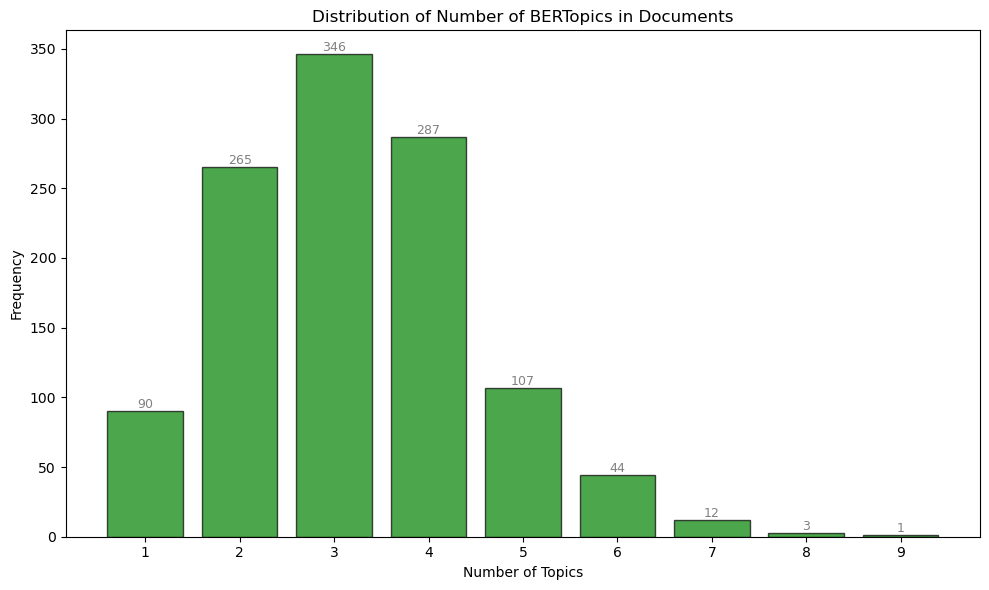

In [14]:
import matplotlib.pyplot as plt
import numpy as np

def plot_num_topics_distribution(num_topics_series):
    """
    Plots the distribution of the number of topics in the given pandas Series.

    Parameters:
    num_topics_series (pd.Series): A pandas Series containing the number of topics.
    """
    # Calculate the frequency of each number of topics
    topic_counts = num_topics_series.value_counts().sort_index()

    # Create the plot
    plt.figure(figsize=(10, 6))
    bars = plt.bar(topic_counts.index, topic_counts.values, color='green', alpha=0.7, edgecolor='black')

    # Add text labels above the bars
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, height, f'{int(height)}', ha='center', va='bottom', fontsize=9, color='grey')

    # Labeling the axes and title
    plt.xlabel('Number of Topics')
    plt.ylabel('Frequency')
    plt.title('Distribution of Number of BERTopics in Documents')
    plt.xticks(topic_counts.index)

    # Show the plot
    plt.tight_layout()
    plt.show()

# Example usage:
plot_num_topics_distribution(updated_papers_df['num_topics'])
